<a href="https://colab.research.google.com/github/MarioSigal/Elementos-de-Reconocimiento-Visual/blob/main/Laboratorios/Laboratorio6_Optical_Flow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Nombre del Grupo*: Nosotres

*Integrantes*: Lautaro Masetto, Matias Halperin, Leonardo Dominguez, Mario Sigal Aguirre

# ***Optical Flow***

## Algoritmo Lucas-Kanade

El algoritmo Lucas-Kanade intentara encontrar el campo de velocidad de cada pixel utilizando 2 restricciones claves:

*   **Restriccion En la Intencidad Constante**

$$ I(x,y,t) = I(x+δx, y+δy, t+δt )$$

Para poder desarrollar utilizando la Serie de Taylos vamos a suponer que cada $\delta$ es chico, lo que reducira el error de la aproximacion lineal a cero.

$$ I(x+δx, y+δy, t+δt) ≈ I(x,y,t) + I_x δx + I_y δy + I_t δt$$

utilizando la reestriccion tendremos:

$$ 0 ≈ I_x δx + I_y δy + I_t δt$$

y ya que lo que queremos encontrar es la velocidad de cada pixel, dividiremos por $\delta t$. Llameros $u$ a la velocidad horizontal y $v$ a la velocidad vertical, quedandonos:

$$ 0 ≈ I_xu + I_yv + I_t $$

Donde

$I_x = \frac{({I_t}_x + {I_{(t+1)}}_x)}{2}$ |
$I_y = \frac{({I_t}_y + {I_{(t+1)}}_y)}{2}$ |
$I_t = I_{(t+1)}- {I_t}$


Con una unica reestricciones tendremos una ecuacion para encontrar 2 incognitas, por lo que no nos es suficiente. Es por esto que se Lucas-Kanade agrega la segunda reestriccion al model



*   **Reestriccion Espacial**

> *Dada una ventana, todo los pixeles de esta ventana se moveran en la misma direccion*

Suponiendo una ventat de 5 x 5 tendremos centrada en x', y':

$$ 0 ≈ I_x(x'-2, y'-2)u + I_y(x'-2, y'-2)v + I_t(x'-2, y'-2) $$
$$ 0 ≈ I_x(x'-1, y'-2)u + I_y(x'-1, y'-2)v + I_t(x'-1, y'-2) $$
$$...$$
$$ 0 ≈ I_x(x'+2, y'+2)u + I_y(x'+2, y'+2)v + I_t(x'+2, y'+2) $$

Consiguiendo 25 ecuaciones con unicamente 2 incognitas, poniendolo en forma matricial tendremos:

$$
\begin{bmatrix}
I_x(x'-2, y'-2) & I_y(x'-2, y'-2)\\
\vdots & \vdots \\
I_x(x'+2, y'+2) & I_y(x'+2, y'+2)\\
\end{bmatrix}
⋅
\begin{bmatrix}
u \\
v \\
\end{bmatrix}
=
\begin{bmatrix}
-I_t(x'-2, y'-2)\\
\vdots \\
-I_t(x'+2, y'+2)\\
\end{bmatrix}
$$

Ahora podemos pasar el sistema a forma normal:

$$
A=\begin{bmatrix}
I_x(x'-2, y'-2) & I_y(x'-2, y'-2)\\
\vdots & \vdots \\
I_x(x'+2, y'+2) & I_y(x'+2, y'+2)\\
\end{bmatrix}
\\
\\
x=\begin{bmatrix}
u \\
v \\
\end{bmatrix}
\\
\\
b=\begin{bmatrix}
-I_t(x'-2, y'-2)\\
\vdots \\
-I_t(x'+2, y'+2)\\
\end{bmatrix}
$$

$$Ax= b$$
$$A^TAx= A^Tb$$

$$
\begin{bmatrix}
\Sigma_W I_xI_x & \Sigma_W I_xI_y\\
\Sigma_W I_xI_y & \Sigma_W I_yI_y\\
\end{bmatrix}
⋅
\begin{bmatrix}
u \\
v \\
\end{bmatrix}
=
\begin{bmatrix}
-\Sigma_W I_xI_t\\
-\Sigma_W I_yI_t\\
\end{bmatrix}
$$
\
**$A^TA$ es la misma matriz de HARRIS**
Es por esta razon que al realizar seguimiento, se eliguen puntos a seguir con el algoritmo de Harris, ya que aseguran que la matriz es reversible y bien condisionada *(ambos autovalores de igual magnitud y no nulos)*


In [ ]:
import numpy as np
from skimage import filters
from skimage.color import rgb2gray

def lucas_kanade_optical_flow(img_inicio, img_siguiente, window_size=5, points=None, delta = 1):
    """
    Parameters
    ----------
    img_inicio : ndarray
        Primer Frame
    img_siguiente : ndarray
        Frame siguiente.
    window_size : int
        Tamano de la ventana.
    points : ndarray
        Puntos en donde calcular optical flow, si es None se calcula en cada pixel
    delta: float
        coeficiente sobre la distancia entre los frames

    Returns
    -------
    (u, v) : tupla de ndarrays
        Optical flow.
    """

    epsilon=1e-6

    # --- Pasamos a blanco y negro ---
    if img_inicio.ndim == 3:
        img_inicio = rgb2gray(img_inicio)
    if img_siguiente.ndim == 3:
        img_siguiente = rgb2gray(img_siguiente)

    img_inicio = img_inicio.astype(float)
    img_siguiente = img_siguiente.astype(float)

    # --- Gradiantes espaciales ---
    # utilicen filters.sobel_v y filters.sobel_h
    Ix = filters.sobel_v(img_inicio)
    Iy = filters.sobel_h(img_inicio)
    It = img_siguiente - img_inicio

    h, w = img_inicio.shape

    # mitad de la ventana
    r = window_size // 2

    if points is None:
      points = [(i, j) for i in range(h) for j in range(w)]
      points = np.array(points)

    u = []
    v = []

    # --- Resolvemos el sistema de ecuaciones por cada punto ---
    for y,x in points:

      y_min = max(0, y - r)
      y_max = min(h, y + r + 1)
      x_min = max(0, x - r)
      x_max = min(w, x + r + 1)

      # Extraemos la ventana (usen .flatten())
      Ix_win = Ix[y_min:y_max, x_min:x_max].flatten()
      Iy_win = Iy[y_min:y_max, x_min:x_max].flatten()
      It_win = It[y_min:y_max, x_min:x_max].flatten()

      # Construimos A y B (pueden utilizar np.vstack)
      A = np.vstack((Ix_win, Iy_win)).T
      b = -It_win

      # Ecuaciones normales (@ multiplicacion de matrices)
      ATA = A.T @ A
      ATb = A.T @ b

      # regularizacion para estabilidad
      ATA += epsilon * np.eye(2)

      # resolvemos para (u, v)
      flow = np.linalg.solve(ATA, ATb*delta)
      u.append(flow[0])
      v.append(flow[1])

    return np.asarray(u), np.asarray(v)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def draw_flow(img, u, v, threshold=0.5, step=1, head_width=1, points=None):
    """
    Dibujamos flechas si la magnitud es mayor a un umbral.
    """

    h, w = img.shape[:2]

    fig, ax = plt.subplots(figsize=(8, 6))
    ax.imshow(img, cmap='gray')

    if points is None:
        Y, X = np.mgrid[0:h, 0:w]
        points = np.vstack((Y.ravel(), X.ravel())).T

    magnitude = np.sqrt(u**2 + v**2)
    idxs = np.where(magnitude > threshold)[0]

    for k, idx in enumerate(idxs):
        if k % step != 0:
            continue

        y, x = points[idx]
        ax.arrow(x, y, u[idx], v[idx], color='red', head_width=head_width)

    ax.set_axis_off()
    plt.show()


### **Prueba de Implementacion**

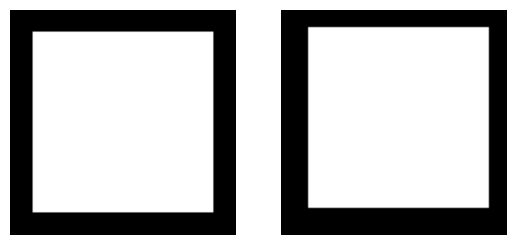

In [ ]:
# Dibujamos dos cuadrados movidos

size = 80
half = size//2
offset = 2

test_1 = np.zeros((100,100))
test_1[50-half:50+half,50-half:50+half] = 1

# Cuadrado desplazado 2 a la derecha y 2 para arriba
test_2 = np.zeros((100,100))
test_2[50-half-offset:50+half-offset,50-half+offset:50+half+offset] = 1

fig, axs = plt.subplots(1,2)

axs[0].imshow(test_1, cmap="gray")
axs[0].axis("off")

axs[1].imshow(test_2, cmap="gray")
axs[1].axis("off")

plt.show()

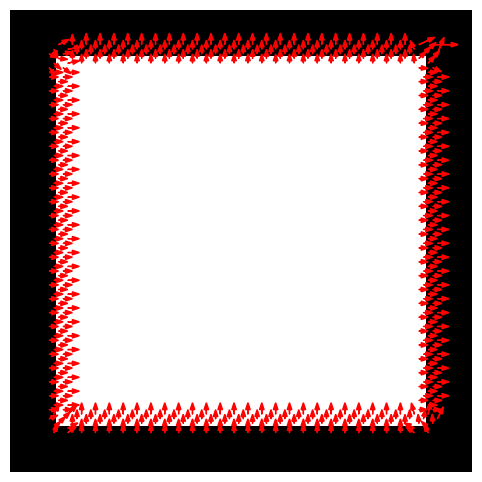

In [ ]:
# Calculamos su optical flow
# notar que la manitud es 0 para las zonas homogeneas
# Porque?

u, v = lucas_kanade_optical_flow(test_1, test_2)
draw_flow(test_1, u, v, 0, 3)


## ***Seguiemientos de Objetos con Optical Flow y Harris***

*Carpeta con los videos: [Link](https://drive.google.com/drive/folders/1Ql1K3AVWyqWVi6gQPNPhR9WLLybFMlpV?usp=drive_link)*

### **Importar Video**

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving bicicleta.mp4 to bicicleta.mp4


In [ ]:
import cv2

# deconstruimos el video en frames individuales
cap = cv2.VideoCapture("bicicleta.mp4")
frames = []

while True:
    ret, frame = cap.read()
    if not ret:
        break

    img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames.append(img_rgb)

cap.release()
print("Number of frames:", len(frames))


Number of frames: 360


### **Encontramos los puntos de Esquina del objeto a seguir**

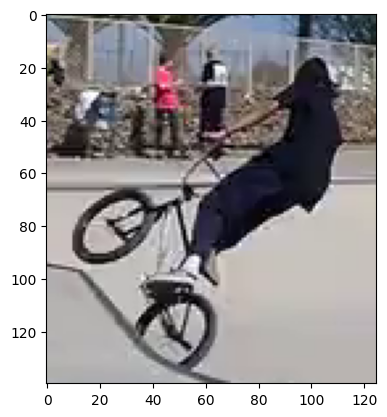

In [ ]:
# Encontramos el objeto que queremos seguir
# En este caso una bicicleta
bicicleta_t = 0
bicicleta_y = [150,290]
bicicleta_x = [50,175]

frame_bicicleta = frames[bicicleta_t]
bicicleta = frame_bicicleta[bicicleta_y[0]:bicicleta_y[1],bicicleta_x[0]:bicicleta_x[1]]

plt.imshow(bicicleta)
plt.show()

In [ ]:
from skimage.feature import corner_harris, corner_subpix, corner_peaks

#Encontramos los puntos de esquina relevantes
frame_bicicleta_g = rgb2gray(frame_bicicleta)
coords = corner_peaks(corner_harris(frame_bicicleta_g))
coords_subpix = corner_subpix(frame_bicicleta_g, coords, window_size=13)

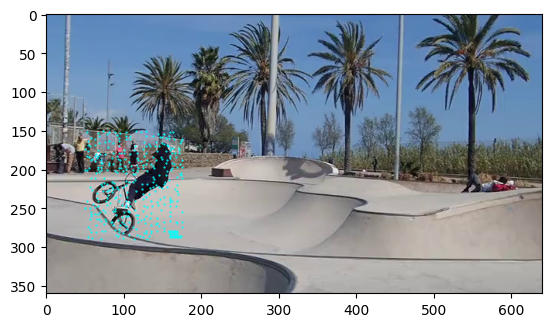

In [ ]:
# Encontramos los puntos claves dentro de la zona donde se encuentra nuestro objeto

puntos_claves = []
for y,x in coords:
  if y >= bicicleta_y[0] and y <= bicicleta_y[1] and x >= bicicleta_x[0] and x <= bicicleta_x[1]:
    puntos_claves.append([y,x])

coords = np.asarray(puntos_claves)
fig, ax = plt.subplots()
ax.imshow(frame_bicicleta)
ax.plot(
    coords[:, 1], coords[:, 0], color='cyan', marker='o', linestyle='None', markersize=0.5
)
plt.show()

### ***Seguimiento Iterativo***

In [ ]:
def draw_points(img, points):
    """
    Draw arrows only if magnitude > threshold.
    """
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.imshow(img)

    for point in points:
      x = point[1]
      y = point[0]
      ax.plot(x, y, color='cyan', marker='o', linestyle='None', markersize=0.5)

    ax.set_axis_off()
    plt.show()

In [ ]:
def update_points_to_track(points_to_track, frame, v, u):

  # Actualizamos donde se encuentran los puntos a seguir segun las velocidades calculadas

  h,w = frame.shape[:2]
  points_to_track = points_to_track + (np.vstack((v, u))).T
  points_to_track = points_to_track.astype(int) #(Recuerden que el tipo de dato debe ser Integer)

  # Eliminamos la que ya no se encuentran en el frame
  mask = (points_to_track[:, 0] >= 25) & (points_to_track[:, 0] <= h-25) & \
       (points_to_track[:, 1] >= 25) & (points_to_track[:, 1] <= w-25)

  points_to_track = points_to_track[mask]

  return points_to_track

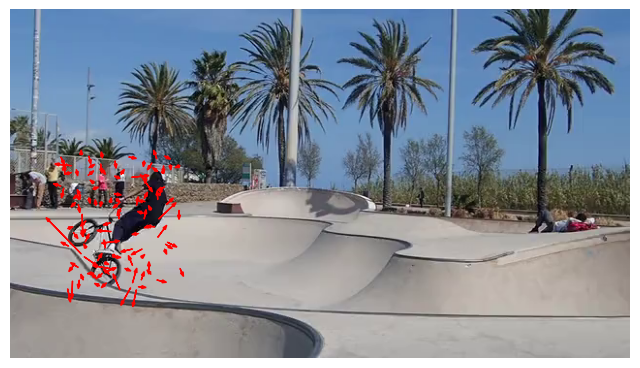

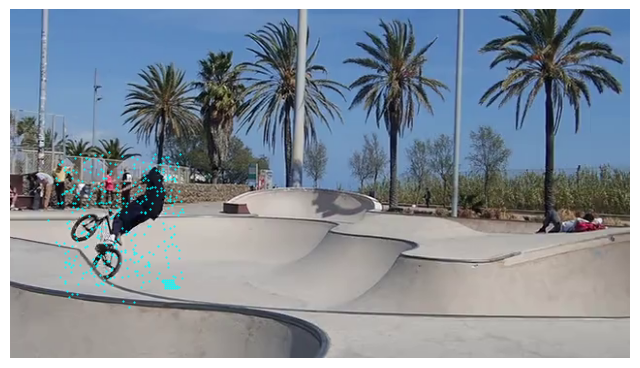

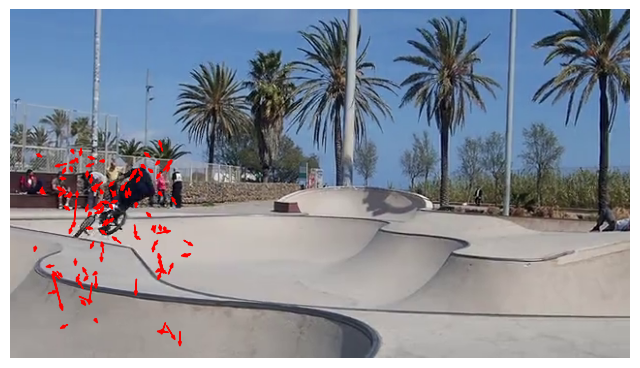

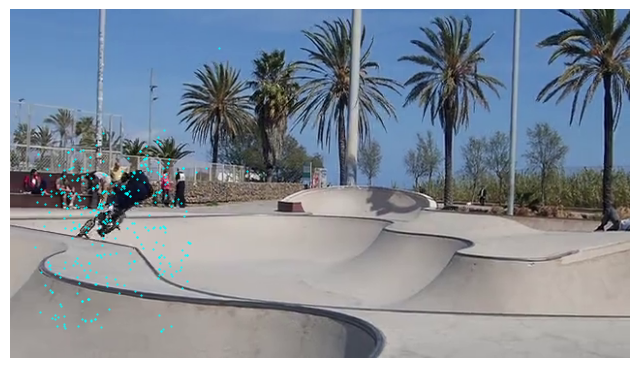

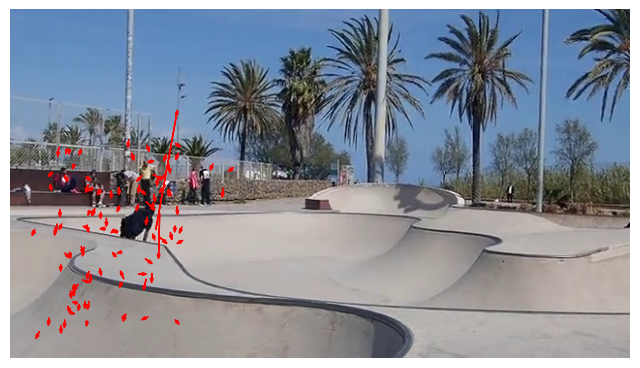

...

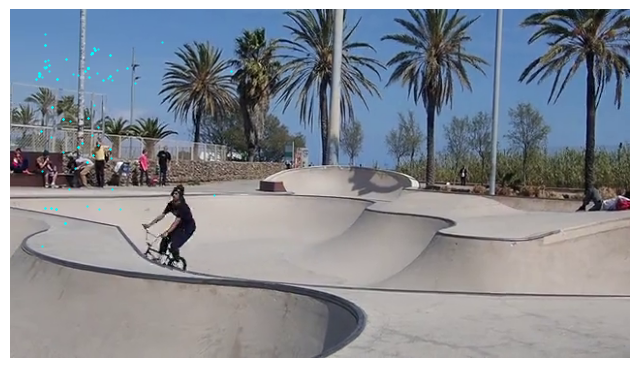

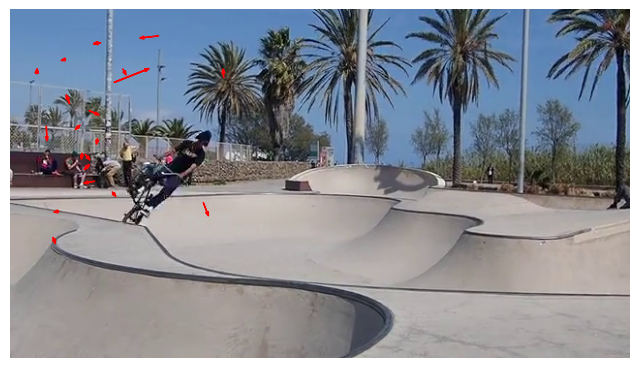

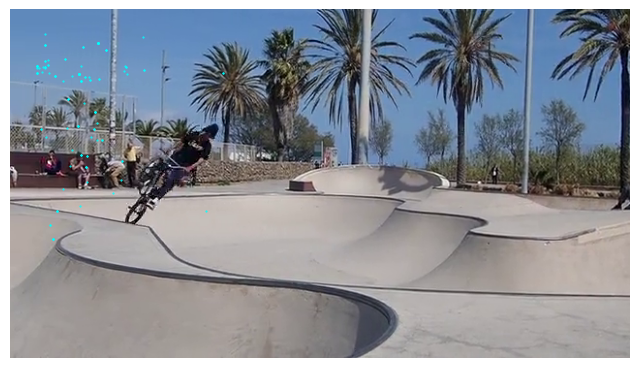

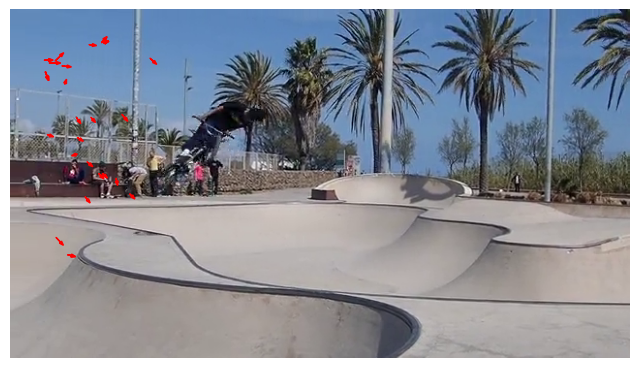

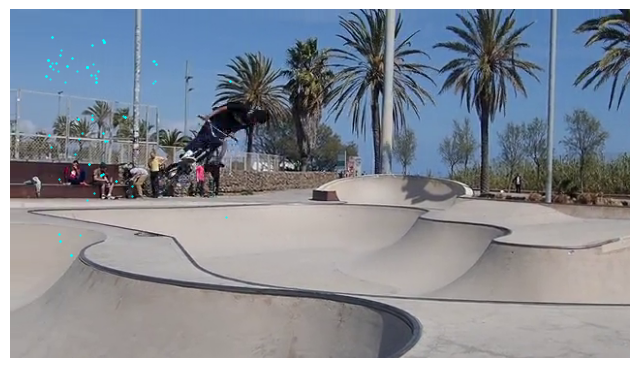

In [ ]:
# Inicializamos los puntos a Seguir
points_to_track = coords.copy()
ultimo_frame = 121
SHOW_STEP = 10

frame_old = bicicleta_t

# En cada iteracion, encontramos la velocidad de los puntos a seguir
# Actualizamos su posicion en el siguiente frames
# repetimos
for i in range(ultimo_frame - bicicleta_t):

  show = (i % SHOW_STEP) == 0

  # Calculamos optical flow (Utilicen delta = 5)
  u, v = lucas_kanade_optical_flow(frames[frame_old], frames[frame_old + 1], window_size=5, points=points_to_track, delta=5)

  if show:
    draw_flow(frames[frame_old], u, v, points=points_to_track, threshold=0.5, step=3, head_width=3)

  # Actualizamos la posicion de nuestros puntos
  # COMPLETAR
  points_to_track = update_points_to_track(points_to_track,frames[frame_old], v,u)

  if show:
    draw_points(frames[frame_old+1],points_to_track)

  # Nos movemos al siguiente Frame
  # COMPLETAR
  frame_old = frame_old + 1



## ***Ejercicio***: Realizar un seguimiento de la motocicleta en el segundo video que se encuentra en el laboratorio

### ***Seguimiento***

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving motocicleta.mp4 to motocicleta.mp4


In [ ]:
import cv2

# deconstruimos el video en frames individuales
cap = cv2.VideoCapture("motocicleta.mp4")
frames_moto = []

while True:
    ret, frame = cap.read()
    if not ret:
        break

    img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames_moto.append(img_rgb)

cap.release()
print("Number of frames:", len(frames_moto))


Number of frames: 410


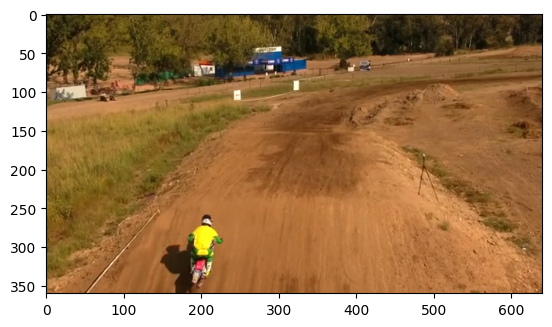

In [ ]:
plt.imshow(frames_moto[28])
plt.show()

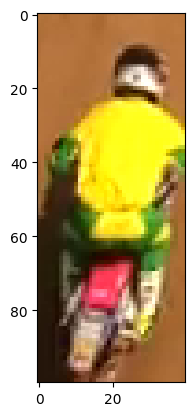

In [ ]:
# Encontramos el objeto que queremos seguir
# En este caso una motocicleta
motocicleta_t = 28
motocicleta_y = [250,350]
motocicleta_x = [180,220]

frame_motocicleta = frames_moto[motocicleta_t]
motocicleta = frame_motocicleta[motocicleta_y[0]:motocicleta_y[1],motocicleta_x[0]:motocicleta_x[1]]

plt.imshow(motocicleta)
plt.show()

In [ ]:
frame_motocicleta_g = rgb2gray(frame_motocicleta)
coords = corner_peaks(corner_harris(frame_motocicleta_g))
coords_subpix = corner_subpix(frame_motocicleta_g, coords, window_size=13)

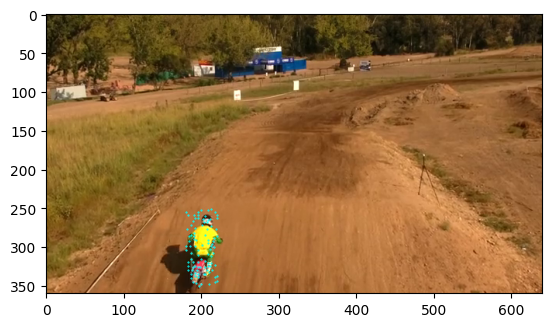

In [ ]:
# Encontramos los puntos claves dentro de la zona donde se encuentra nuestro objeto

puntos_claves = []
for y,x in coords:
  if y >= motocicleta_y[0] and y <= motocicleta_y[1] and x >= motocicleta_x[0] and x <= motocicleta_x[1]:
    puntos_claves.append([y,x])

coords = np.asarray(puntos_claves)
fig, ax = plt.subplots()
ax.imshow(frame_motocicleta)
ax.plot(
    coords[:, 1], coords[:, 0], color='cyan', marker='o', linestyle='None', markersize=0.5
)
plt.show()

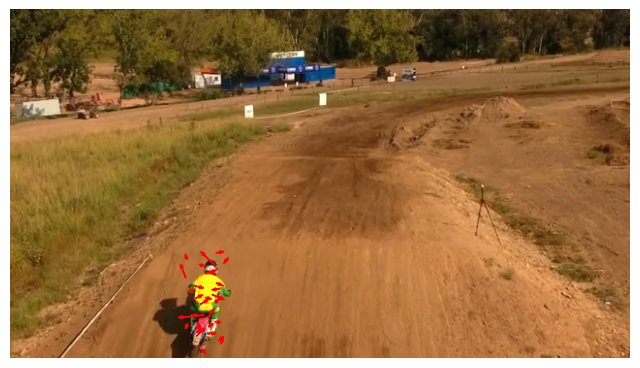

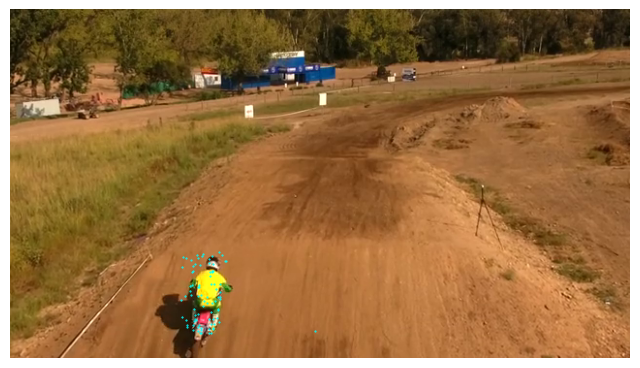

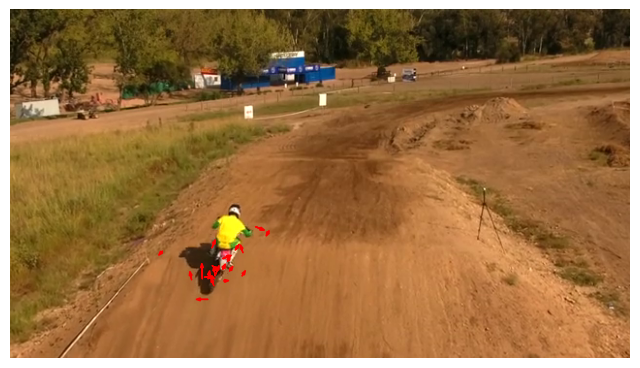

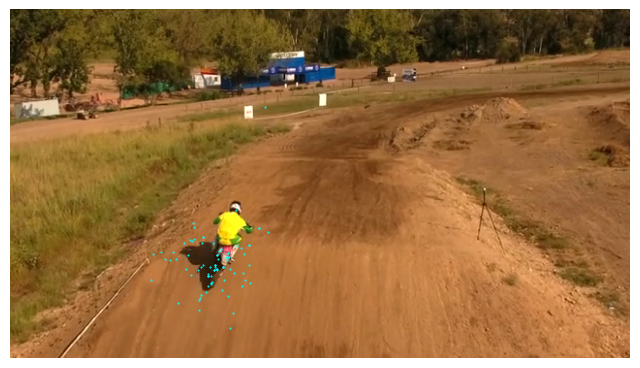

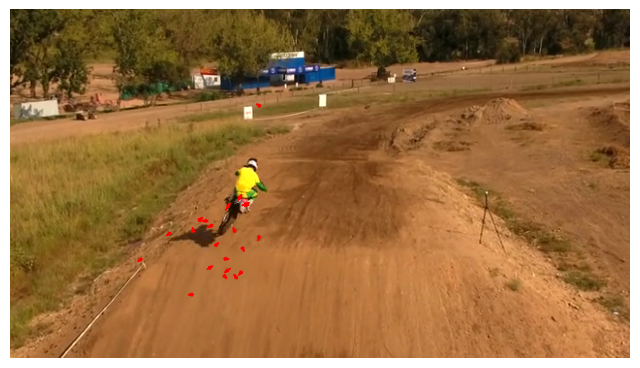

...

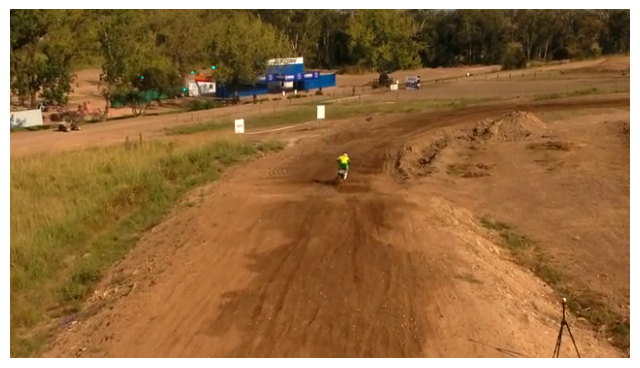

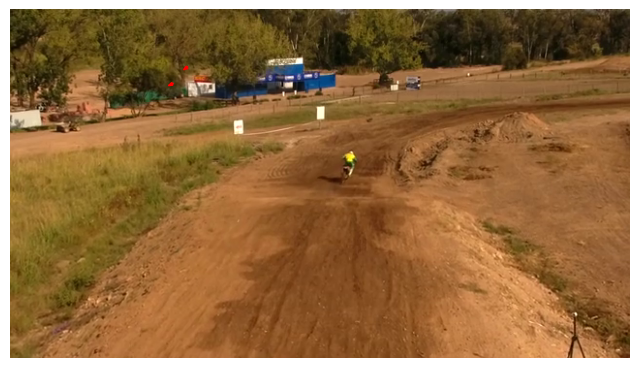

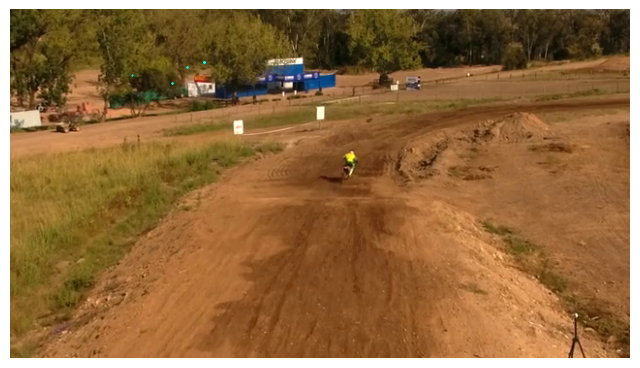

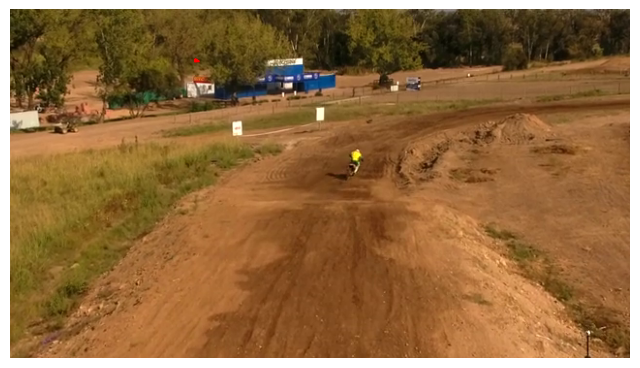

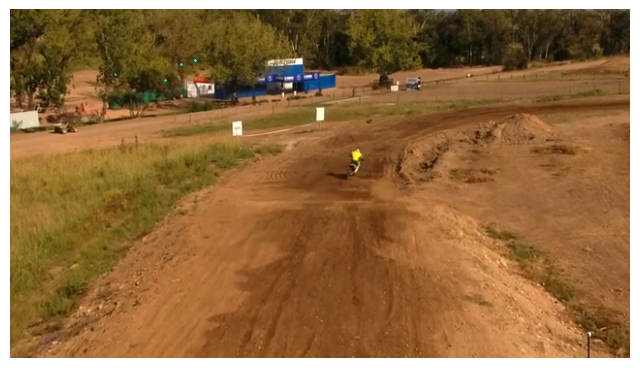

In [ ]:
# Inicializamos los puntos a Seguir
points_to_track = coords.copy()
ultimo_frame = 300
SHOW_STEP = 15

frame_old = motocicleta_t

# En cada iteracion, encontramos la velocidad de los puntos a seguir
# Actualizamos su posicion en el siguiente frames
# repetimos
for i in range(ultimo_frame - motocicleta_t):

  show = (i % SHOW_STEP) == 0

  # Calculamos optical flow (Utilicen delta = 5)
  u, v = lucas_kanade_optical_flow(frames_moto[frame_old], frames_moto[frame_old + 1], window_size=5, points=points_to_track, delta=5)

  if show:
    draw_flow(frames_moto[frame_old], u, v, points=points_to_track, threshold=0.5, step=3, head_width=3)

  # Actualizamos la posicion de nuestros puntos
  # COMPLETAR
  points_to_track = update_points_to_track(points_to_track,frames_moto[frame_old], v,u)

  if show:
    draw_points(frames_moto[frame_old+1],points_to_track)

  # Nos movemos al siguiente Frame
  # COMPLETAR
  frame_old = frame_old + 1